In [97]:
import os
import sys
import numpy as np
import cv2
import re

import tensorflow as tf

import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Tracking video
Dans ce notebook, nous mettons en place une méthode de tracking video

In [ ]:
def display_images(images, lab, n_line, l_col):
    """ Function used to display mutliple image with pyplot
    """
    plt.figure(figsize=(10, 10))
    idx = lab > 0.8
    lab = lab[idx]
    images = images[idx]
    for i in range(min(n_line*l_col, len(images))):
        ax = plt.subplot(n_line, l_col, i + 1)
        plt.imshow(images[i])
        plt.title(f'({lab[i]:.2})')
        plt.axis("off")

In [114]:
def read_bounding_box(path):
    """ Read the bouding box file of a video
    """
    boxes = {}
    m = re.search('VIDEOS/(.+)\.mp4', path)
    filename = m.group(1)
    
    f = open(f'../GT/{filename}_2_bboxes.txt', 'r')
    lines = f.readlines()
    
    for l in lines:
        elmts = l.split(' ')
        frame = int(elmts[0])
        
        if elmts[1] == '1':
            boxes[frame] = (int(elmts[2]), int(elmts[3]), int(elmts[4]), int(elmts[5]))
            
    return boxes

In [115]:
def build_boxes(x, y, w, h, N, stride, H, W):
    """ Build a set of new potential bouding boxes from a given box
    """
    # N = 15
    # stride = 1
    shift = list(range(-N, N+1, stride))
    zoom = [0.89, 0.76, 1, 1.1, 1.25]
    
    pos = [(x, y, w, h)]
    for i in shift:
        new_x = x + i
        
        for j in shift:
            new_y = y + j
            
            new_pos = (new_x, new_y, w, h)
            pos.append(new_pos)
            
            for z in zoom:
                new_w, new_h = int(w*z), int(h*z)
                
                
                new_x = new_x + ((w - new_w) // 2)
                new_y = new_y + ((h - new_h) // 2)
                
                new_x = min(max(0, new_x), W)
                new_y = min(max(0, new_y), H)
                
                new_w = min((W - new_x), new_w)
                new_h = min((H - new_y), new_h)
                
                pos.append((new_x, new_y, new_w, new_h))
            
    return pos

In [116]:
model = tf.keras.models.load_model('../models/best_models', custom_objects=None, compile=True, options=None)

In [117]:
def bb_intersection_over_union(boxA, boxB):
    # determine the (x, y)-coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    
    a = boxA[0] + boxA[2] 
    b = boxA[1] + boxA[3]
    
    c = boxB[0] + boxB[2] 
    d = boxB[1] + boxB[3]
    
    xB = min(a, c)
    yB = min(b, d)
    
    # compute the area of intersection rectangle
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    
    # compute the area of both the prediction and ground-truth
    # rectangles
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
    # compute the intersection over union by taking the intersection
    # area and dividing it by the sum of prediction + ground-truth
    # areas - the interesection area
    iou = interArea / float(boxAArea + boxBArea - interArea)
    # return the intersection over union value
    return iou

Loading 226 frames


<ipython-input-118-96a32bc498c5>:43: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax = plt.subplots(1)


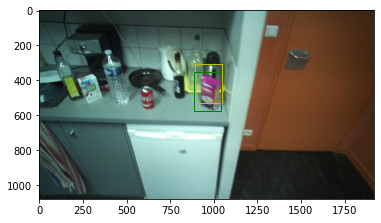

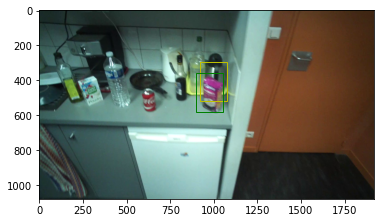

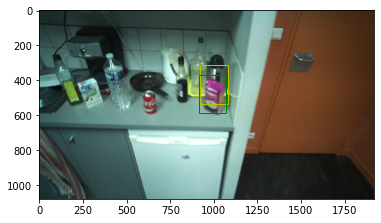

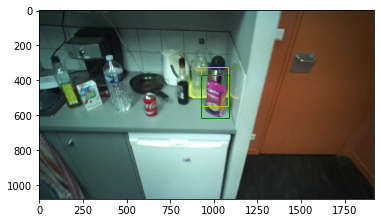

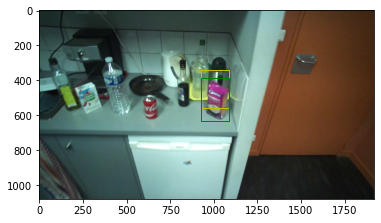

...

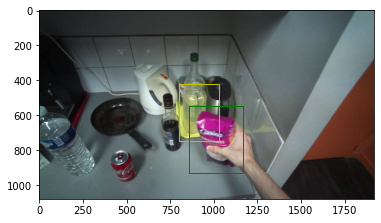

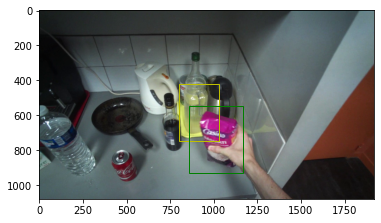

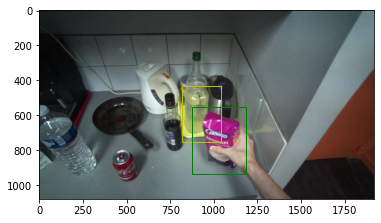

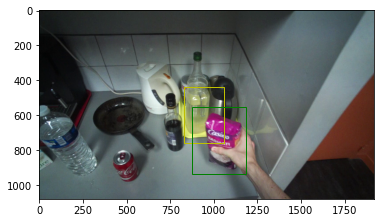

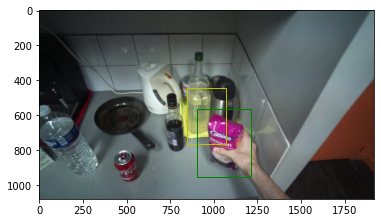

In [118]:
labels = { 0: 'bol', 1: 'coca', 2: 'lait', 3: 'riz', 4: 'sucre' }
filename = '../VIDEOS/RicePlace3Subject3.mp4'

# on ouvre le fichier
cap = cv2.VideoCapture(filename)
nframes = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

# on récupère les boundings box du fichier
boxes = read_bounding_box(filename)
ious = {}

if(not cap.isOpened()):
    print("ERROR: unable to read video:", video_filename)
    sys.exit()

print(f'Loading {nframes} frames')

if 'CanOfCocaCola' in filename:
    label = 1
elif 'MilkBottle' in filename:
    label = 2
elif 'Bowl' in filename:
    label = 0
elif 'Rice' in filename:
    label = 3
elif 'Sugar' in filename:
    label = 4

foundObj = False
for f in range(nframes):
    ret, frame = cap.read()

    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    f_width, f_height, _ = frame.shape
    
    if foundObj or f in boxes:
        if not foundObj:
            box = boxes[f] # première bounding box (= box de référence)
        else:
            x, y, w, h = box
            new_boxes = build_boxes(x, y, w, h, 100, 25, f_width, f_height)

            fig,ax = plt.subplots(1)
            plt.imshow(frame)

            pred_boxes = np.zeros((0, 227, 227, 3))

            t = 0

            for potential_box in new_boxes:
                t+= 1
                x1, y1, w1, h1 = potential_box

                new_patch = frame[y1:y1+h1, x1:x1+w1, :]
                #print(new_patch.shape)
                if 0 not in new_patch.shape:
                    new_patch = tf.image.resize(new_patch, (227, 227), method='nearest')
                    pred_boxes = tf.concat((pred_boxes, tf.expand_dims(new_patch, 0)), axis=0)


                #rect = patches.Rectangle((x1, y1), w1, h1, linewidth=1, edgecolor='r', facecolor='none')
                #ax.add_patch(rect)

            if pred_boxes.shape[0] > 0:
                pred = model.predict(pred_boxes / 255)
                best_pred = np.argmax(pred[:, label])

                # on récupère le patch associé à la meilleure prédiction
                # best_patch = patches[best_pred]
                best_box = new_boxes[best_pred]
                x2, y2, w2, h2 = best_box
                rect = patches.Rectangle((x2, y2), w2, h2, linewidth=1, edgecolor='y', facecolor='none')
                ax.add_patch(rect)

                # on modifie la current box pour la frame suivante
                box = best_box
                # predict_boxes[f] = best_box

            # display real box
            #rect = patches.Rectangle((x, y), w, h, linewidth=1, edgecolor='g', facecolor='none')
            #ax.add_patch(rect)
            
            if f in boxes:
                a, b, c, d = boxes[f]
                rect = patches.Rectangle((a, b), c, d, linewidth=1, edgecolor='g', facecolor='none')
                ax.add_patch(rect)
                
                iou = bb_intersection_over_union(box, boxes[f])
                ious[f] = iou
                
                plt.savefig(f'img/frame__best{f}.png')
                
            #fig, ax = plt.subplots(1)
            #display_images(pred_boxes, pred[:, label], 10, 10)
            #plt.savefig(f'img/frame__best{f}_pred.png')
            
        foundObj = True

In [112]:
ious

{25: 0.03059028758369218,
 26: 0.035477799705875626,
 27: 0.03119645494830133,
 28: 0.03370534158412008,
 29: 0.04452874382606039,
 30: 0.04860433520657074,
 31: 0.044789879382314525,
 32: 0.029137081892284943,
 33: 0.027234479879243344,
 34: 0.020768559516499144,
 35: 0.02746133830821346,
 36: 0.022159341815239,
 37: 0.022717513060925402,
 38: 0.021060563783294798,
 39: 0.022563669383790175,
 40: 0.024204791282749778,
 41: 0.016526500365366986,
 42: 0.008646466693239731,
 43: 0.007510347918665295,
 44: 0.007279937079858704,
 45: 0.00822150284072366,
 46: 0.00846265845058274,
 47: 0.021882685407560897,
 48: 0.021669274751317642,
 49: 0.02330641741214376,
 50: 0.023951408399918172,
 51: 0.023951408399918172,
 52: 0.023951408399918172,
 53: 0.02519107306634057,
 54: 0.02519107306634057,
 55: 0.02519107306634057,
 56: 0.025634605668159446,
 57: 0.025634605668159446,
 58: 0.039281215372481214,
 59: 0.03719779773757169,
 60: 0.03434331777471769,
 61: 0.036090738836167986,
 62: 0.03609073883